# Importing and installing libraries

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
import os
import numpy as np

In [2]:
!pip install kapre==0.3.7

  Using cached kapre-0.3.7.tar.gz (26 kB)
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Using cached librosa-0.10.2.post1-py3-none-any.whl.metadata (8.6 kB)
  Using cached audioread-3.0.1-py3-none-any.whl.metadata (8.4 kB)
  Using cached soundfile-0.12.1-py2.py3-none-win_amd64.whl.metadata (14 kB)
  Using cached pooch-1.8.2-py3-none-any.whl.metadata (10 kB)
  Using cached pycparser-2.22-py3-none-any.whl.metadata (943 bytes)
Using cached librosa-0.10.2.post1-py3-none-any.whl (260 kB)
   ---------------------------------------- 0.0/75.2 kB ? eta -:--:--
   ---------------- ----------------------- 30.7/75.2 kB 1.3 MB/s eta 0:00:01
   ---------------------------------------- 75.2/75.2 kB 1.0 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\ntana\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [3]:
!pip install tensorflow==2.15.0

  Using cached tensorflow-2.15.0-cp311-cp311-win_amd64.whl.metadata (3.6 kB)
  Using cached tensorflow_intel-2.15.0-cp311-cp311-win_amd64.whl.metadata (5.1 kB)
   ---------------------------------------- 0.0/300.9 MB ? eta -:--:--
   ---------------------------------------- 0.3/300.9 MB 4.2 MB/s eta 0:01:12
   ---------------------------------------- 0.5/300.9 MB 2.4 MB/s eta 0:02:06
   ---------------------------------------- 0.5/300.9 MB 2.4 MB/s eta 0:02:06
   ---------------------------------------- 0.6/300.9 MB 1.3 MB/s eta 0:03:46
   ---------------------------------------- 0.7/300.9 MB 1.3 MB/s eta 0:03:53
   ---------------------------------------- 0.7/300.9 MB 1.3 MB/s eta 0:03:53
   ---------------------------------------- 0.7/300.9 MB 1.3 MB/s eta 0:03:53
   ---------------------------------------- 0.7/300.9 MB 1.3 MB/s eta 0:03:53
   ---------------------------------------- 0.7/300.9 MB 901.1 kB/s eta 0:05:34
   ---------------------------------------- 0.7/300.9 MB 901.1 kB


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\ntana\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [7]:
!pip install librosa


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\ntana\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [15]:
!pip install soundfile

ERROR: Could not find a version that satisfies the requirement libsndfile (from versions: none)
ERROR: No matching distribution found for libsndfile

[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\ntana\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [3]:
import matplotlib.pyplot as plt
import os
import numpy as np
import matplotlib
import sys
from PIL import Image
import scipy
import IPython.display as ipd
import librosa
import librosa.display
#import libfmp.c2

In [4]:
"""from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.layers import BatchNormalization
from keras.layers import Activation
from keras.layers import Dropout
from keras.layers import Lambda
from keras.optimizers import Adam, SGD

from tensorflow.keras.metrics import AUC

from tensorflow.keras.backend import l2_normalize"""

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

import kapre
from kapre.composed import get_melspectrogram_layer
from keras.callbacks import CSVLogger, ModelCheckpoint
from IPython.display import Audio
from models import *


In [5]:
import tensorflow as tf
print(tf.config.list_physical_devices('GPU'))

[]


# If using goodle drive, adapt the path bellow to the files location

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)
sys.path.append("/content/drive/MyDrive/ 'folder path with files here' ")


# Loading your audio file

We provided three audio files for testing. But we encourage the user to use their own to experiment with the models. If the user wants to use other files just change the name of the path on the code bellow

In [6]:
moon, sr = librosa.load("moonsonata1.mp3")

In [7]:
Audio(moon, rate = sr)

In [8]:
doom, sr = librosa.load("doom.mp3")
doom_full, sr = librosa.load("doom_full.mp3")

In [9]:
Audio(doom, rate = sr)

These are some of the audios used in the paper to test the models

# Loading the models

Each model was trained using the same parameters. They are listed bellow.
It is important to notice that on the CRNN architectures, the input shape can be diferent than the one listed, since our architecture can handle inputs of any time leght.

In [10]:
sr = 22050
input_shape = (220000,1)
n_fft = 2048 + 1024
n_mels = 1024
hop_length = n_fft//4
n_feat = 64

In [11]:
name_dict = {"blues":0,'classical':1,'country':2 , 'disco':3 , 'rock':4,
        'hiphop': 5 ,  'jazz':6,
        'pop':7 , 'reggae':8, "metal":9}

# just a dictionary with the genre names

In [12]:
model = model_CRNN_VK(sr,input_shape,n_fft,n_mels,hop_length,n_feat)

C:\Users\ntana\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\kapre\backend.py:141: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  filterbank = librosa.filters.mel(



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 nt_melspec (Sequential)     (None, 283, 1024, 1)      0         
                                                                 
 conv1 (Conv2D)              (None, 283, 4, 64)        262208    
                                                                 
 bnorm0 (BatchNormalization  (None, 283, 4, 64)        256       
 )                                                               
                                                                 
 activation (Activation)     (None, 283, 4, 64)        0         
                                                                 
 conv2 (Conv2D)              (None, 276, 1, 64)        131136    
                                                                 
 bnorm1 (BatchNormalization  (None, 276, 1, 64)        256       
 )                                                     

In [13]:
# creating the model v-kernel and the number of parameters in the network
model = model_CNN_VK(sr,input_shape,n_fft,n_mels,hop_length,n_feat)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 nt_melspec (Sequential)     (None, 283, 1024, 1)      0         
                                                                 
 conv1 (Conv2D)              (None, 281, 52, 64)       98368     
                                                                 
 bnorm0 (BatchNormalization  (None, 281, 52, 64)       256       
 )                                                               
                                                                 
 activation_2 (Activation)   (None, 281, 52, 64)       0         
                                                                 
 maxpool1 (MaxPooling2D)     (None, 140, 26, 64)       0         
                                                                 
 bnorm1 (BatchNormalization  (None, 140, 26, 64)       256       
 )                                                    

In [14]:
# Creating the model BICRNN for inputs with diferent time lenght
sr = 22050
input_shape = (moon.shape[0],1)
input_shape2 = (doom_full.shape[0],1)
input_shape3 = (220000,1)
n_fft = 2048 + 1024
n_mels = 1024
hop_length = n_fft//4
n_feat = 64
model2 = model_BICRNN_VK(sr,input_shape,n_fft,n_mels,hop_length,n_feat)
model3 = model_BICRNN_VK(sr,input_shape2,n_fft,n_mels,hop_length,n_feat)
model4 = model_BICRNN_VK(sr,input_shape3,n_fft,n_mels,hop_length,n_feat)

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 nt_melspec (Sequential)     (None, 10323, 1024, 1)    0         
                                                                 
 conv1 (Conv2D)              (None, 10323, 4, 64)      262208    
                                                                 
 bnorm0 (BatchNormalization  (None, 10323, 4, 64)      256       
 )                                                               
                                                                 
 activation_7 (Activation)   (None, 10323, 4, 64)      0         
                                                                 
 conv2 (Conv2D)              (None, 10316, 1, 64)      131136    
                                                                 
 bnorm1 (BatchNormalization  (None, 10316, 1, 64)      256       
 )                                                    

In [15]:
# loadin the trained model
model.load_weights("weights_model_v_kernel_10s_ps.h5", by_name=False)
model2.load_weights("weights_model_BICRNN_10s_ps.h5", by_name=False)
model3.load_weights("weights_model_BICRNN_10s_ps.h5", by_name=False)
model4.load_weights("weights_model_BICRNN_10s_ps.h5", by_name=False)

In [16]:
# creating the predictions
doom_scores = model4.predict(doom[:220000].reshape(1,-1,1))
moon_scores = model2.predict(moon.reshape(1,-1,1))
doom_full_scores = model3.predict(doom_full.reshape(1,-1,1))



1/1 [==============================] - 1s 1s/step


In [17]:
print("Classifications using BICRNN model \n")
print(f'Sonata was classified as {list(name_dict.keys())[moon_scores.argmax()]}')
print(f'Doom was classified as {list(name_dict.keys())[doom_scores.argmax()]}')
print(f'Doom complete was classified as {list(name_dict.keys())[doom_full_scores.argmax()]}')

Classifications using BICRNN model 

Sonata was classified as classical
Doom was classified as pop
Doom complete was classified as pop


In [18]:
doom_scores2 = model.predict(doom[:220000].reshape(1,-1,1))
moon_scores2 = model.predict(moon[10000:10000+220000].reshape(1,-1,1))

1/1 [==============================] - 0s 30ms/step


In [19]:
print("Classifications using vkernel_L2 model \n")
print(f'Sonata was classified as {list(name_dict.keys())[moon_scores2.argmax()]}')
print(f'Doom was classified as {list(name_dict.keys())[doom_scores2.argmax()]}')


Classifications using vkernel_L2 model 

Sonata was classified as classical
Doom was classified as hiphop


## Probability Vector

### Vector of predicted probabilities returned by BICRNN model for the audios moonlight sonata, Doom and Doom complete respectively

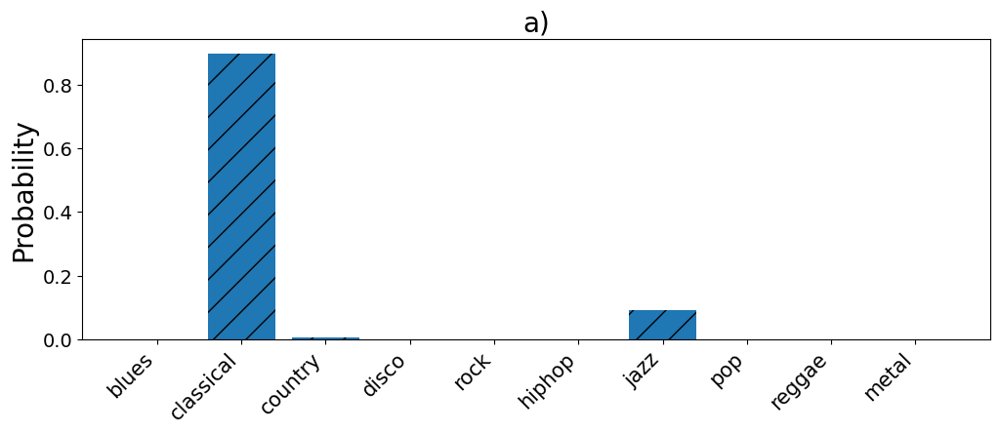

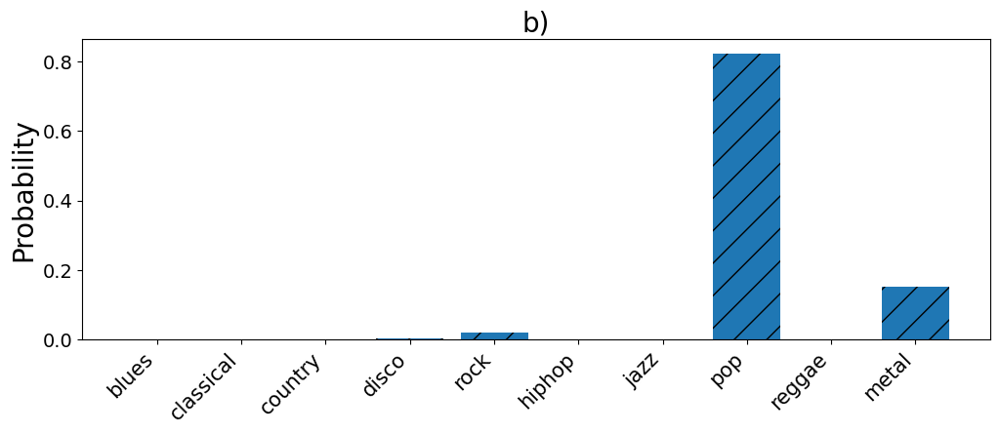

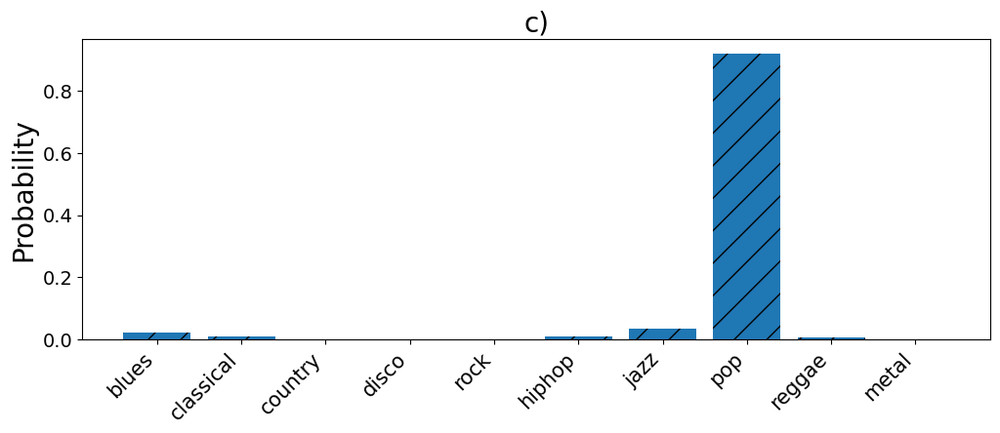

In [20]:
labels = list(name_dict.keys())
pattern = '/'

# Gráfico a)
plt.figure(figsize=(12,4))
bars = plt.bar(labels, moon_scores[0])
for bar in bars:
    bar.set_hatch(pattern)  # Aplica padrão de preenchimento
plt.xticks(rotation=45, ha='right', fontsize=15)
plt.ylabel('Probability', fontsize=20)
plt.tick_params(axis='y', labelsize=14)
plt.title('a)', fontsize=20)
plt.show()

# Gráfico b)
plt.figure(figsize=(12,4))
bars = plt.bar(labels, doom_scores[0])
for bar in bars:
    bar.set_hatch(pattern)  # Aplica padrão de preenchimento
plt.xticks(rotation=45, ha='right', fontsize=15)
plt.ylabel('Probability', fontsize=20)
plt.tick_params(axis='y', labelsize=14)
plt.title('b)', fontsize=20)
plt.show()

# Gráfico c)
plt.figure(figsize=(12,4))
bars = plt.bar(labels, doom_full_scores[0])
for bar in bars:
    bar.set_hatch(pattern)  # Aplica padrão de preenchimento
plt.xticks(rotation=45, ha='right', fontsize=15)
plt.ylabel('Probability', fontsize=20)
plt.tick_params(axis='y', labelsize=14)
plt.title('c)', fontsize=20)
plt.show()

### Vector of predicted probabilities returned by BICRNN model for the audios moonlight sonata, Doom and Doom complete respectively

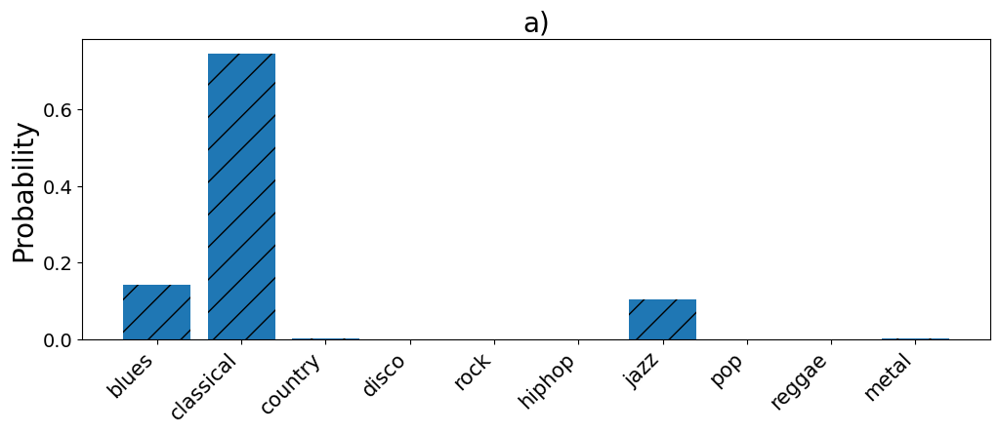

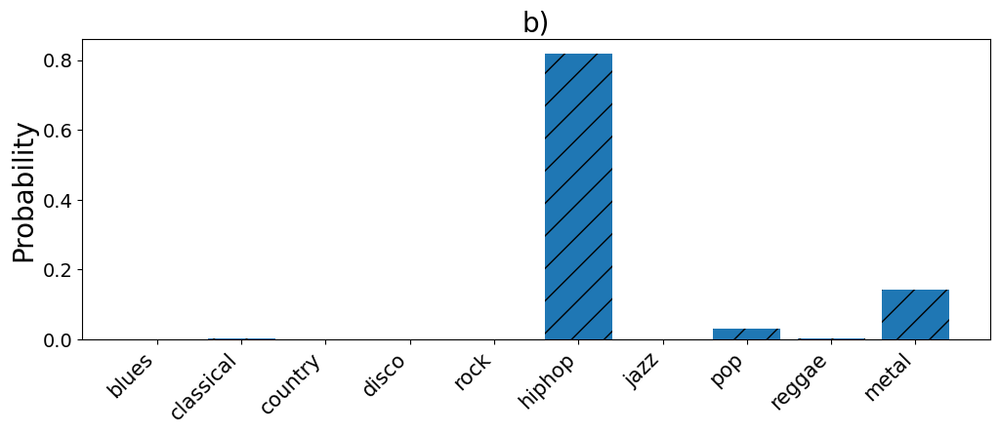

In [21]:
labels = list(name_dict.keys())
pattern = '/'

# Gráfico a)
plt.figure(figsize=(12,4))
bars = plt.bar(labels, moon_scores2[0])
for bar in bars:
    bar.set_hatch(pattern)  # Aplica padrão de preenchimento
plt.xticks(rotation=45, ha='right', fontsize=15)
plt.ylabel('Probability', fontsize=20)
plt.tick_params(axis='y', labelsize=14)
plt.title('a)', fontsize=20)
plt.show()

# Gráfico b)
plt.figure(figsize=(12,4))
bars = plt.bar(labels, doom_scores2[0])
for bar in bars:
    bar.set_hatch(pattern)  # Aplica padrão de preenchimento
plt.xticks(rotation=45, ha='right', fontsize=15)
plt.ylabel('Probability', fontsize=20)
plt.tick_params(axis='y', labelsize=14)
plt.title('b)', fontsize=20)
plt.show()

### Now we can make a animation using both models to classify a sliding window. For this  we choose the audio doom full

In [32]:
pred_vec_vkernel = []
pred_vec_bicrnn = []
for i in range(80):
    pred_vec_vkernel.append(model.predict(doom_full[ i*110000 : (i+2)*110000].reshape(1,-1,1)))
    pred_vec_bicrnn.append(model4.predict(doom_full[ i*110000 : (i+2)*110000].reshape(1,-1,1)))



1/1 [==============================] - 0s 30ms/step


In [23]:
from ipywidgets import interactive



### Here we have a slider showing how the v-kernel and BICRNN models classify the genre for a slinding window with 10 seconds duration on the music Doom

In [37]:
def plot_graphs(i):
    labels = list(name_dict.keys())
    pattern = '/'

    # Gráfico a)
    plt.figure(figsize=(12,4))
    bars = plt.bar(labels, pred_vec_vkernel[i][0])
    for bar in bars:
        bar.set_hatch(pattern)  # Aplica padrão de preenchimento
    plt.xticks(rotation=45, ha='right', fontsize=15)
    plt.ylabel('Probability', fontsize=20)
    plt.tick_params(axis='y', labelsize=14)
    plt.title('v_kernel_ps', fontsize=20)
    plt.ylim(0,1)
    plt.text(x = 7, y = 1.2, s = f'Time window: {i*5//60}m:{(i*5)%60}s to {(i+2)*5//60}m:{((i+2)*5)%60}s', fontsize = 14)
    plt.show()

    # Gráfico b)
    plt.figure(figsize=(12,4))
    bars = plt.bar(labels, pred_vec_bicrnn[i][0])
    for bar in bars:
        bar.set_hatch(pattern)  # Aplica padrão de preenchimento
    plt.xticks(rotation=45, ha='right', fontsize=15)
    plt.ylabel('Probability', fontsize=20)
    plt.tick_params(axis='y', labelsize=14)
    plt.title('BICRNN_ps', fontsize=20)
    plt.ylim(0,1)
    plt.show()

slider = interactive(plot_graphs, i=(0, 79))


In [38]:
display(slider)

interactive(children=(IntSlider(value=39, description='i', max=79), Output(outputs=({'output_type': 'display_d…

In [41]:
import matplotlib.pyplot as plt
import imageio

def plot_graphs(i, save=False):
    labels = list(name_dict.keys())
    pattern = '/'
    
    # Criando uma figura com dois subplots, um abaixo do outro
    fig, axs = plt.subplots(2, 1, figsize=(12, 8))  # Ajuste o tamanho conforme necessário

    # Gráfico a)
    axs[0].bar(labels, pred_vec_vkernel[i][0])
    for bar in axs[0].patches:
        bar.set_hatch(pattern)  # Aplica padrão de preenchimento
    axs[0].set_xticklabels(labels, rotation=45, ha='right', fontsize=15)
    axs[0].set_ylabel('Probability', fontsize=20)
    axs[0].tick_params(axis='y', labelsize=14)
    axs[0].set_title('v_kernel_ps', fontsize=20)
    axs[0].set_ylim(0,1)
    axs[0].text(x = 7, y = 1.2, s = f'Time window: {i*5//60}m:{(i*5)%60}s to {(i+2)*5//60}m:{((i+2)*5)%60}s', fontsize = 14)
    
    # Gráfico b)
    axs[1].bar(labels, pred_vec_bicrnn[i][0])
    for bar in axs[1].patches:
        bar.set_hatch(pattern)  # Aplica padrão de preenchimento
    axs[1].set_xticklabels(labels, rotation=45, ha='right', fontsize=15)
    axs[1].set_ylabel('Probability', fontsize=20)
    axs[1].tick_params(axis='y', labelsize=14)
    axs[1].set_title('BICRNN_ps', fontsize=20)
    axs[1].set_ylim(0,1)
    plt.tight_layout()

    if save:
        filename = f'frame_{i}.png'
        plt.savefig(filename)
        plt.close()  # Feche a figura para liberar memória
        return filename

# Criar GIF
def create_gif():
    filenames = []
    for i in range(0, 79):  # Supondo que seu slider vai de 0 a 48
        filename = plot_graphs(i, save=True)
        filenames.append(filename)
    
    # Criar o GIF
    with imageio.get_writer('combined_animation.gif', mode='I', fps=2) as writer:
        for filename in filenames:
            image = imageio.imread(filename)
            writer.append_data(image)
            os.remove(filename)  # Opcional: remover o arquivo após adicionar ao GIF

create_gif()


C:\Users\ntana\AppData\Local\Temp\ipykernel_25924\3613560505.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[0].set_xticklabels(labels, rotation=45, ha='right', fontsize=15)
C:\Users\ntana\AppData\Local\Temp\ipykernel_25924\3613560505.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[1].set_xticklabels(labels, rotation=45, ha='right', fontsize=15)
C:\Users\ntana\AppData\Local\Temp\ipykernel_25924\3613560505.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[0].set_xticklabels(labels, rotation=45, ha='right', fontsize=15)
C:\Users\ntana\AppData\Local\Temp\ipykernel_25924\3613560505.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  a